In [1]:
import pandas as pd
import numpy as np 
import matplotlib.pyplot as plt 
import folium
from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans,AgglomerativeClustering
from scipy.cluster.hierarchy import dendrogram

from ClusterFunctions import print_boxplots,make_map, draw_clusters,filter_clusters_by_roadID,convert_column_to_string


%matplotlib inline
pd.set_option('display.width', 1000)

# Get data

In [2]:
caracteristics=pd.read_csv('Data\caracteristics.csv', encoding='latin-1')
caracteristics.dropna(inplace=True)
caracteristics.reindex()
caracteristics.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 223493 entries, 0 to 839572
Data columns (total 16 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   Num_Acc  223493 non-null  int64  
 1   an       223493 non-null  int64  
 2   mois     223493 non-null  int64  
 3   jour     223493 non-null  int64  
 4   hrmn     223493 non-null  int64  
 5   lum      223493 non-null  int64  
 6   agg      223493 non-null  int64  
 7   int      223493 non-null  int64  
 8   atm      223493 non-null  float64
 9   col      223493 non-null  float64
 10  com      223493 non-null  float64
 11  adr      223493 non-null  object 
 12  gps      223493 non-null  object 
 13  lat      223493 non-null  float64
 14  long     223493 non-null  object 
 15  dep      223493 non-null  int64  
dtypes: float64(4), int64(9), object(3)
memory usage: 29.0+ MB


In [3]:
caracteristics.describe(include='all')

,Num_Acc,an,mois,jour,hrmn,lum,agg,int,atm,col,com,adr,gps,lat,long,dep
count,2.234930e+05,223493.000000,223493.000000,223493.000000,223493.000000,223493.000000,223493.000000,223493.000000,223493.000000,223493.000000,223493.000000,223493,223493,2.234930e+05,223493.0,223493.000000
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,156751,9,NaN,116350.0,NaN
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,A4,M,NaN,0.0,NaN
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1005,216574,NaN,44780.0,NaN
mean,2.011772e+11,11.772136,6.583754,15.556957,1387.027773,1.901299,1.773443,1.733598,1.542603,4.128921,196.355157,NaN,NaN,3.277844e+06,NaN,526.958106
std,3.371611e+08,3.371662,3.380630,8.762770,535.366688,1.522132,0.418605,1.594964,1.591858,2.006971,170.049420,NaN,NaN,2.149108e+06,NaN,284.559494
min,2.005000e+11,5.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000,1.000000,NaN,NaN,0.000000e+00,NaN,10.000000
25%,2.009001e+11,9.000000,4.000000,8.000000,1008.000000,1.000000,2.000000,1.000000,1.000000,3.000000,55.000000,NaN,NaN,4.000000e+00,NaN,300.000000
50%,2.012000e+11,12.000000,7.000000,15.000000,1500.000000,1.000000,2.000000,1.000000,1.000000,3.000000,149.000000,NaN,NaN,4.504770e+06,NaN,510.000000
75%,2.015000e+11,15.000000,10.000000,23.000000,1810.000000,2.000000,2.000000,2.000000,1.000000,6.000000,282.000000,NaN,NaN,4.852889e+06,NaN,770.000000


In [4]:
caracteristics['long']=caracteristics['long'].apply(pd.to_numeric,errors='ignore')
object_types=caracteristics['long'].apply(type)

indices = [i for i, x in enumerate(list(object_types)) if x == str]
print(f'droped str data: {len(indices)}')

caracteristics.drop(caracteristics.index[indices], inplace=True)
caracteristics['long']=caracteristics['long'].apply(pd.to_numeric,errors='ignore')
caracteristics['long']=caracteristics['long'].div(100000)
caracteristics['lat']=caracteristics['lat'].div(100000)
caracteristics.info()

droped str data: 2202
<class 'pandas.core.frame.DataFrame'>
Int64Index: 221291 entries, 0 to 839572
Data columns (total 16 columns):
 #   Column   Non-Null Count   Dtype  
---  ------   --------------   -----  
 0   Num_Acc  221291 non-null  int64  
 1   an       221291 non-null  int64  
 2   mois     221291 non-null  int64  
 3   jour     221291 non-null  int64  
 4   hrmn     221291 non-null  int64  
 5   lum      221291 non-null  int64  
 6   agg      221291 non-null  int64  
 7   int      221291 non-null  int64  
 8   atm      221291 non-null  float64
 9   col      221291 non-null  float64
 10  com      221291 non-null  float64
 11  adr      221291 non-null  object 
 12  gps      221291 non-null  object 
 13  lat      221291 non-null  float64
 14  long     221291 non-null  float64
 15  dep      221291 non-null  int64  
dtypes: float64(5), int64(9), object(2)
memory usage: 28.7+ MB


In [5]:
caracteristics.describe(include='all')

,Num_Acc,an,mois,jour,hrmn,lum,agg,int,atm,col,com,adr,gps,lat,long,dep
count,2.212910e+05,221291.000000,221291.000000,221291.000000,221291.000000,221291.000000,221291.000000,221291.000000,221291.000000,221291.000000,221291.000000,221291,221291,221291.000000,221291.000000,221291.000000
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,155148,9,NaN,NaN,NaN
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,A4,M,NaN,NaN,NaN
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1005,214372,NaN,NaN,NaN
mean,2.011800e+11,11.799721,6.582125,15.557167,1386.850143,1.901447,1.772621,1.732343,1.541581,4.129427,195.788351,NaN,NaN,33.104605,1.845747,527.091016
std,3.376930e+08,3.376980,3.380758,8.761904,535.480250,1.521912,0.419141,1.594619,1.590445,2.007123,169.974889,NaN,NaN,21.346301,4.229032,285.433025
min,2.005000e+11,5.000000,1.000000,1.000000,1.000000,1.000000,1.000000,0.000000,1.000000,1.000000,1.000000,NaN,NaN,0.000000,-5.246000,10.000000
25%,2.009001e+11,9.000000,4.000000,8.000000,1005.000000,1.000000,2.000000,1.000000,1.000000,3.000000,55.000000,NaN,NaN,0.000040,0.000000,300.000000
50%,2.012000e+11,12.000000,7.000000,15.000000,1500.000000,1.000000,2.000000,1.000000,1.000000,3.000000,149.000000,NaN,NaN,45.155100,1.113000,510.000000
75%,2.015000e+11,15.000000,10.000000,23.000000,1810.000000,2.000000,2.000000,2.000000,1.000000,6.000000,281.000000,NaN,NaN,48.553295,3.223210,770.000000


### Select only accidents near Paris

In [6]:
filtered_data=caracteristics.iloc[np.where((caracteristics['lat']>=48) & (caracteristics['lat']<=49.5) & (caracteristics['long']<=3.5) & (caracteristics['long']>1.5))]
filtered_data

,Num_Acc,an,mois,jour,hrmn,lum,agg,int,atm,col,com,adr,gps,lat,long,dep
362,201600000363,16,2,19,1845,5,2,1,1.0,6.0,602.0,Rue du 7° BCA,M,49.48930,3.44609,20
402,201600000403,16,11,19,600,3,2,1,1.0,6.0,71.0,21 rue du pont araby,M,49.41023,3.13601,20
410,201600000411,16,4,18,815,1,2,1,1.0,6.0,810.0,AVENUE DE COMPIEGNE,M,49.25664,3.08494,20
411,201600000412,16,5,1,1445,1,2,1,1.0,3.0,307.0,"2, rue de verdun",M,49.17802,3.12734,20
437,201600000438,16,6,9,1615,1,2,1,1.0,2.0,628.0,rue du général de gaulle,M,49.42011,2.15253,600
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
832402,200500079444,5,12,2,830,1,2,1,2.0,6.0,584.0,LE PETIT THERAIN,M,49.24000,2.44000,600
832417,200500079459,5,12,21,1715,3,1,3,8.0,1.0,580.0,Carrefour les Guepelles,M,49.09100,2.55200,950
832543,200500079585,5,12,10,1915,5,2,1,1.0,3.0,353.0,RN1/RUE DE BEAUMONT,M,49.08700,2.31500,950
832581,200500079623,5,12,22,530,3,1,1,1.0,6.0,399.0,PK 69+800,M,48.25000,3.35300,890


In [7]:
coords = filtered_data[['lat','long']]

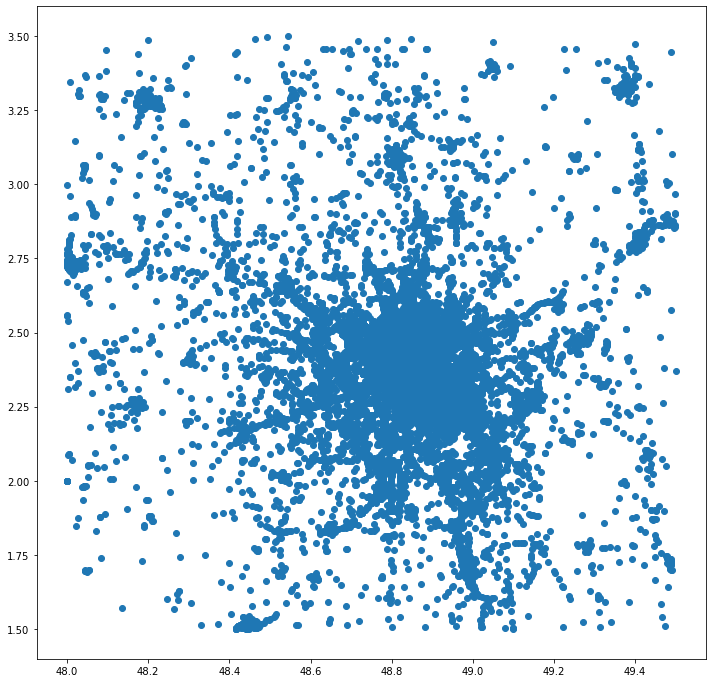

In [8]:
plt.rcParams["figure.figsize"] = (12,12)
plt.scatter(filtered_data['lat'], filtered_data['long'])
plt.show() 

In [9]:
#make_map(filtered_data,number_of_points=500)

In [10]:
places=pd.read_csv('Data\places.csv')

# DBSCAN 

In [11]:
kms_per_radian = 6371.0088
MIN_CLUSTER_SIZE=15
MAX_DISTANCE=.03
epsilon = MAX_DISTANCE / kms_per_radian

In [56]:
dbscan_data=filtered_data

In [13]:
db = DBSCAN(eps=epsilon, min_samples=MIN_CLUSTER_SIZE, metric='haversine',n_jobs=-1).fit(np.radians(dbscan_data[['lat','long']].to_numpy()))

In [57]:
dbscan_data['cluster']=db.labels_
num_clusters = len(set(db.labels_))-1
num_clusters

73

In [15]:
#draw_clusters(dbscan_data)

In [58]:
merged_clusterized = pd.merge(left=dbscan_data, right=places, left_on='Num_Acc', right_on='Num_Acc')
merged_clusterized['voie']=merged_clusterized['voie'].astype('int32',errors='ignore').astype('str',errors='ignore')

In [59]:
merged_clusterized.describe(include='all')

,Num_Acc,an,mois,jour,hrmn,lum,agg,int,atm,col,...,pr1,vosp,prof,plan,lartpc,larrout,surf,infra,situ,env1
count,3.422000e+04,34220.000000,34220.000000,34220.000000,34220.000000,34220.000000,34220.000000,34220.000000,34220.000000,34220.000000,...,21518.000000,34090.000000,34103.000000,34102.000000,30635.000000,30668.000000,34104.000000,34101.00000,34123.000000,34120.000000
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,2.013279e+11,13.278317,5.877674,15.501899,1378.517008,1.930392,1.723758,1.839158,1.534220,4.173670,...,276.800539,0.108947,1.136909,1.129083,7.082846,61.195057,1.255923,0.46157,1.091698,58.181536
std,2.615517e+08,2.615515,3.292078,8.794398,547.930514,1.557796,0.447144,1.501421,1.525751,1.855681,...,317.623859,0.521906,0.524676,0.607466,21.199568,64.564992,0.818666,1.35182,0.632300,48.495501
min,2.005000e+11,5.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000
25%,2.011001e+11,11.000000,3.000000,8.000000,940.000000,1.000000,1.000000,1.000000,1.000000,3.000000,...,0.000000,0.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.00000,1.000000,0.000000
50%,2.014000e+11,14.000000,6.000000,15.000000,1445.000000,1.000000,2.000000,1.000000,1.000000,3.000000,...,150.000000,0.000000,1.000000,1.000000,0.000000,60.000000,1.000000,0.00000,1.000000,99.000000
75%,2.016000e+11,16.000000,9.000000,23.000000,1815.000000,2.000000,2.000000,2.000000,1.000000,6.000000,...,500.000000,0.000000,1.000000,1.000000,10.000000,100.000000,1.000000,0.00000,1.000000,99.000000


In [60]:
merged_clusterized=filter_clusters_by_roadID(merged_clusterized,MIN_CLUSTER_SIZE)

In [62]:
#draw_clusters(merged_clusterized)

# KMeans

In [20]:
kmeans_data=pd.merge(left=filtered_data, right=places, left_on='Num_Acc', right_on='Num_Acc')
kmeans_data

,Num_Acc,an,mois,jour,hrmn,lum,agg,int,atm,col,...,pr1,vosp,prof,plan,lartpc,larrout,surf,infra,situ,env1
0,201600000363,16,2,19,1845,5,2,1,1.0,6.0,...,700.0,0.0,1.0,1.0,0.0,70.0,1.0,0.0,1.0,99.0
1,201600000403,16,11,19,600,3,2,1,1.0,6.0,...,NaN,0.0,1.0,1.0,0.0,120.0,1.0,0.0,4.0,99.0
2,201600000411,16,4,18,815,1,2,1,1.0,6.0,...,NaN,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,3.0
3,201600000412,16,5,1,1445,1,2,1,1.0,3.0,...,NaN,0.0,1.0,1.0,0.0,59.0,1.0,0.0,1.0,99.0
4,201600000438,16,6,9,1615,1,2,1,1.0,2.0,...,NaN,0.0,2.0,1.0,0.0,0.0,1.0,0.0,1.0,99.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34215,200500079444,5,12,2,830,1,2,1,2.0,6.0,...,0.0,0.0,1.0,1.0,0.0,65.0,2.0,0.0,1.0,0.0
34216,200500079459,5,12,21,1715,3,1,3,8.0,1.0,...,0.0,0.0,1.0,1.0,0.0,140.0,2.0,0.0,1.0,0.0
34217,200500079585,5,12,10,1915,5,2,1,1.0,3.0,...,0.0,0.0,1.0,1.0,10.0,120.0,0.0,5.0,1.0,0.0
34218,200500079623,5,12,22,530,3,1,1,1.0,6.0,...,800.0,0.0,2.0,1.0,30.0,70.0,1.0,0.0,1.0,0.0


In [21]:
kmeans_data.drop(['Num_Acc','dep','com','adr','gps','voie','v1','v2','pr','pr1','cluster'],axis=1,inplace=True)
kmeans_data.dropna(inplace=True)

In [22]:
convert_column_to_string(kmeans_data,['lum','int','atm','col','catr','circ','vosp','prof','plan','surf','situ'])
kmeans_data.describe(include='all')

,an,mois,jour,hrmn,lum,agg,int,atm,col,lat,...,nbv,vosp,prof,plan,lartpc,larrout,surf,infra,situ,env1
count,30599.000000,30599.000000,30599.000000,30599.000000,30599,30599.000000,30599,30599,30599,30599.000000,...,30599.000000,30599,30599,30599,30599.000000,30599.000000,30599,30599.000000,30599,30599.000000
unique,NaN,NaN,NaN,NaN,5,NaN,9,9,7,NaN,...,NaN,4,5,5,NaN,NaN,10,NaN,6,NaN
top,NaN,NaN,NaN,NaN,1,NaN,1,1,6,NaN,...,NaN,0,1,1,NaN,NaN,1,NaN,1,NaN
freq,NaN,NaN,NaN,NaN,21208,NaN,19374,24148,9953,NaN,...,NaN,29027,25165,24994,NaN,NaN,23119,NaN,27698,NaN
mean,13.218242,5.774993,15.511324,1374.807968,NaN,1.712605,NaN,NaN,NaN,48.824776,...,2.375339,NaN,NaN,NaN,7.088728,61.202262,NaN,0.471388,NaN,55.947122
std,2.698312,3.259411,8.786175,549.440770,NaN,0.452555,NaN,NaN,NaN,0.177138,...,1.419683,NaN,NaN,NaN,21.210766,64.593067,NaN,1.361017,NaN,48.878815
min,5.000000,1.000000,1.000000,1.000000,NaN,1.000000,NaN,NaN,NaN,48.000000,...,0.000000,NaN,NaN,NaN,0.000000,0.000000,NaN,0.000000,NaN,0.000000
25%,11.000000,3.000000,8.000000,940.000000,NaN,1.000000,NaN,NaN,NaN,48.777040,...,2.000000,NaN,NaN,NaN,0.000000,0.000000,NaN,0.000000,NaN,0.000000
50%,14.000000,5.000000,15.000000,1440.000000,NaN,2.000000,NaN,NaN,NaN,48.839800,...,2.000000,NaN,NaN,NaN,0.000000,60.000000,NaN,0.000000,NaN,99.000000
75%,16.000000,8.000000,23.000000,1815.000000,NaN,2.000000,NaN,NaN,NaN,48.895000,...,3.000000,NaN,NaN,NaN,10.000000,100.000000,NaN,0.000000,NaN,99.000000


In [23]:
kmeans_one_hot_data=pd.get_dummies(data=kmeans_data, columns=['lum', 'int','atm','col','catr','circ','vosp','prof','plan','surf','situ'])
kmeans_one_hot_data

,an,mois,jour,hrmn,agg,lat,long,nbv,lartpc,larrout,...,surf_6,surf_7,surf_8,surf_9,situ_0,situ_1,situ_2,situ_3,situ_4,situ_5
0,16,2,19,1845,2,49.48930,3.44609,2.0,0.0,70.0,...,0,0,0,0,0,1,0,0,0,0
1,16,11,19,600,2,49.41023,3.13601,2.0,0.0,120.0,...,0,0,0,0,0,0,0,0,1,0
2,16,4,18,815,2,49.25664,3.08494,2.0,0.0,0.0,...,0,0,0,0,0,1,0,0,0,0
3,16,5,1,1445,2,49.17802,3.12734,2.0,0.0,59.0,...,0,0,0,0,0,1,0,0,0,0
4,16,6,9,1615,2,49.42011,2.15253,2.0,0.0,0.0,...,0,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34215,5,12,2,830,2,49.24000,2.44000,2.0,0.0,65.0,...,0,0,0,0,0,1,0,0,0,0
34216,5,12,21,1715,1,49.09100,2.55200,2.0,0.0,140.0,...,0,0,0,0,0,1,0,0,0,0
34217,5,12,10,1915,2,49.08700,2.31500,0.0,10.0,120.0,...,0,0,0,0,0,1,0,0,0,0
34218,5,12,22,530,1,48.25000,3.35300,2.0,30.0,70.0,...,0,0,0,0,0,1,0,0,0,0


In [24]:
scaler = StandardScaler()
kmeans_one_hot_data= scaler.fit_transform(kmeans_one_hot_data)
pca = PCA(.85)
kmeans_one_hot_data=pca.fit_transform(kmeans_one_hot_data)
kmeans_one_hot_data=pd.DataFrame(kmeans_one_hot_data)

In [28]:
inertias=[]
K = list(range(1,97,5))
for k in K:
    kmeans=KMeans(n_clusters=k, random_state=0).fit(kmeans_one_hot_data)
    inertias.append(kmeans.inertia_)

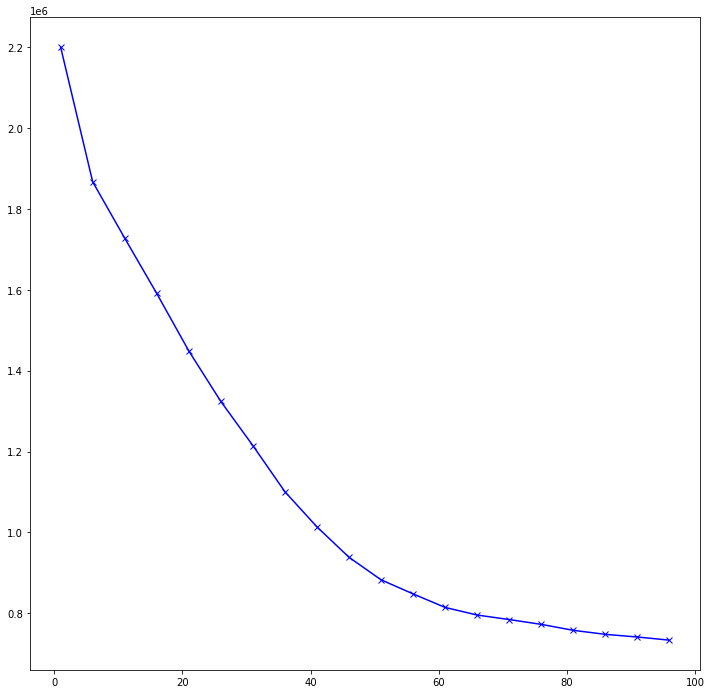

In [29]:
plt.plot(K,inertias, 'bx-')
plt.show()

In [30]:
kmeans=KMeans(n_clusters=50, random_state=0).fit(kmeans_one_hot_data)

In [51]:
kmeans_data['cluster']=kmeans.labels_

# Hierarchical clustering

In [32]:
hierarchical_data=kmeans_data

In [46]:
hierarchical= AgglomerativeClustering(distance_threshold=0, n_clusters=None).fit(hierarchical_data)

In [48]:
def plot_dendrogram(model, **kwargs):
    plt.rcParams["figure.figsize"] = (12,12)
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1
            else:
                current_count += counts[child_idx - n_samples]
                counts[i] = current_count

    linkage_matrix = np.column_stack([model.children_, model.distances_,counts]).astype(float)

    dendrogram(linkage_matrix, **kwargs)


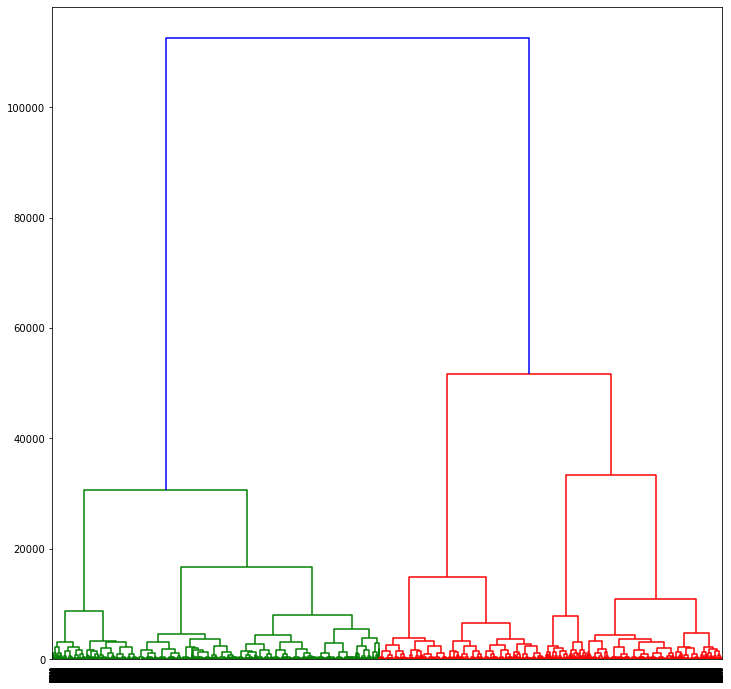

In [49]:
plot_dendrogram(hierarchical)

In [50]:
hierarchical= AgglomerativeClustering(n_clusters=4).fit(hierarchical_data)

In [52]:
hierarchical_data['cluster']=hierarchical.labels_

In [ ]:
def analyse_attributes_values_in_clusters(dataframe,attributes):
    cluster_dict=dataframe.groupby(['cluster']).count().iloc[:,0].to_dict()
    for attribute in attributes:
        unique_attribute_values=dataframe[attribute].unique()
        
        



In [119]:
dbscan_data.groupby(['cluster','lum']).agg({'lum':['count']}).loc[1].index

Int64Index([1, 3, 5], dtype='int64', name='lum')

In [131]:
dbscan_data.groupby(['cluster']).count().iloc[:,0].to_dict()

{-1: 32438,
 0: 20,
 1: 34,
 2: 16,
 3: 18,
 4: 16,
 5: 56,
 6: 17,
 7: 24,
 8: 24,
 9: 19,
 10: 15,
 11: 20,
 12: 25,
 13: 17,
 14: 27,
 15: 21,
 16: 16,
 17: 27,
 18: 23,
 19: 32,
 20: 51,
 21: 18,
 22: 21,
 23: 21,
 24: 15,
 25: 73,
 26: 22,
 27: 22,
 28: 21,
 29: 15,
 30: 21,
 31: 39,
 32: 120,
 33: 48,
 34: 29,
 35: 23,
 36: 15,
 37: 28,
 38: 16,
 39: 28,
 40: 21,
 41: 21,
 42: 19,
 43: 19,
 44: 20,
 45: 24,
 46: 20,
 47: 30,
 48: 17,
 49: 22,
 50: 19,
 51: 25,
 52: 16,
 53: 15,
 54: 21,
 55: 19,
 56: 18,
 57: 31,
 58: 21,
 59: 22,
 60: 15,
 61: 16,
 62: 20,
 63: 55,
 64: 18,
 65: 15,
 66: 15,
 67: 19,
 68: 15,
 69: 16,
 70: 15,
 71: 15,
 72: 15}